In [23]:
import os
import sys
from decimal import Decimal
from collections import defaultdict

module_path = os.path.abspath(os.path.join('../../..'))
if module_path not in sys.path:
    sys.path.append(module_path)
from methods import main_methods as mm
from methods import config

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
import segmentation_gmm as seg_gmm
import segmentation_watershed as seg_water
import ssts_helpers as sh

import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
qnm_fields = ['Adhesion', 'Deformation', 'Dissipation', 'Modulus', 'Height', 'Stiffness']
cafm_fields = ['Height', 'Current']
amfm_fields = ["Height", "Phase", "Young's Modulus", "Deformation"]

In [84]:
lit_files = '/Users/wesleytatum/Dropbox/SSTS_files/Manuscript/data_files/'
opv_files = '/Users/wesleytatum/Desktop/MANA-T/OPV_SSTS/AFM/combined_npy/'

im1_opv = np.load(opv_files+'175C_30min_Sub8_Dev8.npy')
im3_annealed = np.load(lit_files+'P3HT-PCBM_150C_15min_sub2.npy')
im5_PTB7 = np.load(lit_files+'PTB7PC71BM_CBonly_ascast_fresh_500 nm_combined.npy')
im6_OFET = np.load(lit_files+'150C_30min_8_3_combined.npy')
im7_NWs = np.load(lit_files+'100-0_72_NW_combined.npy')
cafm = np.load(lit_files+'WT2-97_cafm.npy')
amfm = np.load(lit_files+'WT2-107_amfm_90.npy')

ims = [im1_opv, im3_annealed, im5_PTB7, im6_OFET, im7_NWs, cafm, amfm]

In [10]:
def ssts_pipeline(dataframe, heightless, outlier_threshold, n_components, padding, embedding_dim, thresh, nonlinear, normalize, zscale, data_type, data_subtype):
    """
    Wrapper function for SSTS tools. Allows to include or exclude SSTS tools in the order shown in the code.
    
    Args:
    dataframe - np.array(). 3D array of SPM data
    heightless - bool. if 'True', height channel is removed. Height is assumed to be dataframe[:,:,4]
    n_components - int. number specifying the number of Gaussian phase distributions to be identified in dataframe
    padding - int. number specifying the degree of closeness of neighbors to be included in GMM labelling
    embedding_dims - int. number specifying the number of principle components to use in PCA before GMM labelling
    nonlinear - bool. if 'True', nonlinear properties are generated prior to analysis. Includes x^2, x^3, abs(x),
                and 1/x
                
    Returns:
    outliers - np.array(). 2D array of outliers
    seg1_labels - np.array(). 2D array of GMM labels
    seg2_labels - np.array(). 2D array of clustering labels
    """
  
    # Apply frequency removal
    data = mm.apply_frequency_removal(dataframe, data_type)
    
    data_properties = config.data_info[data_type]['properties']

    # Extract outliers
    outliers = mm.extract_outliers(data, data_type, threshold = outlier_threshold)
    no_outliers_data = mm.smooth_outliers_from_data(data, outliers)
    
    mm.show_outliers(dataframe, data_type, outliers)

    # Show a-priori distributions
    mm.show_property_distributions(data, data_type, outliers)

    # Run GMM segmentation
    seg1 = seg_gmm.SegmenterGMM(n_components = n_components, embedding_dim = embedding_dim, padding = padding,
                                nonlinear = nonlinear, normalize=normalize, zscale=zscale)

    if heightless == True:
        # Remove height property
        height_id = data_properties.index("Height")
        
        no_height_data = np.delete(no_outliers_data, height_id, axis=2)

        seg1_labels = seg1.fit_transform(no_height_data, outliers)

        mm.show_classification(seg1_labels, no_height_data, data_type)
        mm.show_classification_correlation(seg1_labels, no_height_data, data_type)
        mm.show_distributions_together(seg1_labels, no_height_data, data_type)
        mm.show_grain_area_distribution(seg1_labels, data_type, data_subtype)

        # Overlay distributions on pixels
        probs = seg1.get_probabilities(no_height_data)
        mm.show_overlaid_distribution(probs, no_height_data, data_type)
        
        if embedding_dim != None:
            h, w, c = no_height_data.shape

            pca_components = seg1.get_pca_components(no_height_data)
            pca_components = pca_components.reshape(h, w, embedding_dim)
            mm.show_classification_correlation(seg1_labels, pca_components, data_type, title_flag=False)

            mm.show_classification_distributions(seg1_labels, pca_components, data_type, title_flag=False)

        else:
            pass
            
#         X = np.ravel(seg1_labels)
#         for i in range(5):
#             Y = np.ravel(no_height_data[:,:,i])
#             plt.scatter(X, Y, s = 50, marker = 'o', color = 'r', alpha = 0.1)
#             plt.ticklabel_format(style = 'sci')
#             plt.ylim((Y.min()-Y.min()*0.5), (Y.max()+Y.max()*0.1))
#             plt.show()

        seg2 = seg_water.SegmenterWatershed()
        height_id = data_properties.index("Height")
        height_data = data[:, :, height_id]
        thresh = thresh
        
        seg2_labels = seg2.fit_transform(height_data, outliers, thresh)

        mm.show_classification(seg2_labels, no_height_data, data_type)
        mm.show_grain_area_distribution(seg2_labels, data_type, data_subtype)
        
#         X = np.ravel(seg2_labels)
#         for i in range(5):
#             Y = np.ravel(no_height_data[:,:,i])
#             plt.scatter(X, Y, s = 50, marker = 'o', color = 'r', alpha = 0.1)
#             plt.ticklabel_format(style = 'sci')
#             plt.ylim((Y.min()-Y.min()*0.5), (Y.max()+Y.max()*0.1))
#             plt.show()

        
    elif heightless == False:
        
        seg1_labels = seg1.fit_transform(no_outliers_data, outliers)

        mm.show_classification(seg1_labels, no_outliers_data, data_type)
        mm.show_distributions_together(seg1_labels, no_outliers_data, data_type)

        mm.show_classification(seg1_labels, no_outliers_data, data_type)
        mm.show_classification_correlation(seg1_labels, no_outliers_data, data_type)
        mm.show_distributions_together(seg1_labels, no_outliers_data, data_type)

        # Overlay distributions on pixels
        probs = seg1.get_probabilities(no_outliers_data)
        mm.show_overlaid_distribution(probs, no_outliers_data, data_type)
        mm.show_grain_area_distribution(seg1_labels, data_type, data_subtype)
        
        
        if embedding_dim != None:
            h, w, c = no_outliers_data.shape

            pca_components = seg1.get_pca_components(no_outliers_data)
            pca_components = pca_components.reshape(h, w, embedding_dim)
            mm.show_classification_correlation(seg1_labels, pca_components, data_type, title_flag=False)

            mm.show_classification_distributions(seg1_labels, pca_components, data_type, title_flag=False)

            
        else:
            pass
            
#         X = np.ravel(seg1_labels)
#         for i in range(6):
#             Y = np.ravel(no_outliers_data[:,:,i])
#             plt.scatter(X, Y, s = 50, marker = 'o', color = 'r', alpha = 0.1)
#             plt.ticklabel_format(style = 'sci')
#             plt.ylim((Y.min()-Y.min()*0.5), (Y.max()+Y.max()*0.1))
#             plt.show()
        
        seg2 = seg_water.SegmenterWatershed()
        height_id = data_properties.index("Height")
        height_data = data[:, :, height_id]
        thresh = thresh
        
        seg2_labels = seg2.fit_transform(height_data, outliers, thresh)
        
        mm.show_classification(seg2_labels, no_outliers_data, data_type)
        mm.show_grain_area_distribution(seg2_labels, data_type, data_subtype)

#         X = np.ravel(seg2_labels)
#         for i in range(6):
#             Y = np.ravel(no_outliers_data[:,:,i])
#             plt.scatter(X, Y, s = 50, marker = 'o', color = 'r', alpha = 0.1)
#             plt.ticklabel_format(style = 'sci')
#             plt.ylim((Y.min()-Y.min()*0.5), (Y.max()+Y.max()*0.1))
#             plt.show()
        
    else:
        print ('Error: Heightless flag incorrect')
    
    return outliers, seg1_labels, seg2_labels

In [13]:
def get_stats_dict(labels, dataframe):
    # {component: {property: stats}}
    
    unique_labels = mm.get_unique_labels(labels)
    unique_labels.sort()
#     print (unique_labels)

    stats = defaultdict(dict)
    h, w, c = dataframe.shape
    for l in unique_labels:
        for i in range(c):
            
            # First: dataframe[:,:,i] extracts out the ith property data, i.e., the (h x w) array
            # of pixels for the ith property.
            # Second: labels is a (h x w) array with entries being the different components.
            # Third: (labels == l) is a (h x w) array with entries being 0 or 1. It's 1 if the entries
            # match label l and 0 if they don't.
            # Finally: data[:,:,i][labels == l] extracts all the entries of the ith property data,
            # that match the lth component.
            data = dataframe[:,:,i][labels == l]
            stats[l][i] = [
                np.median(data), np.std(data), np.var(data)
            ]
        
    return stats
        
# p_stats = get_stats_dict(seg1_labels, dataframe)
from random import shuffle

def plot_prop_dists(stats, shuffle):
    """
    This function takes in a dictionary of stats generated by get_stats_dict()
    
    Args:
    stats - dict() of dict() of dict() of lists
    
    Returns:
    None - plots are generated
    """

    # Gather plotting points per property
    data_plots = defaultdict(list)
    for num_components, nc_dict in stats.items():
        for component, c_dict in nc_dict.items():
            for prop, stats in c_dict.items():
                median, std, var = stats    
                data_plots[prop].append([num_components, median, std])


    # Complex Plot
    for prop, tups in data_plots.items():
        plt.figure(figsize=(12,5))
        plt.title(f"Property: {qnm_fields[prop]}")

        # Shuffle is purely aesthetic. It's used to randomize the data points to be plotted. 
        # If shuffle is taken out (try this out), the colors in the plot will resemble the cmap (gist_ncar) sequence. 
        # With shuffle in, the colors used in plotting are more random, i.e., easier to distinguish from neighbors.
    #     shuffle(tups)

        x_data, y_data, e_data = zip(*tups)

        cmap = plt.cm.get_cmap("prism", len(x_data))
        colors = [cmap(i) for i in range(len(x_data))]

        for (x, y, e), color in zip(tups, colors):
            plt.errorbar(x, y, yerr=e, color=color, fmt='o', ecolor=color, elinewidth=2, capsize=5, capthick=3)

        plt.ylim(min(np.array(y_data) - 1.15 * np.array(e_data)) , max(np.array(y_data) + 1.15 * np.array(e_data)))
        plt.grid()
        plt.show(), 
def label_comparison(seg1_labels, seg2_labels):
    """
    A function that compares which grain label corresponds to which phase. Returns a dictionary of tuples corresponding
    to each grain. tuple is (seg2_label, seg1_label)
    
    Args:
    seg1_labels - np.array(). 2d array containing the labels resulting from GMM classification
    seg2_labels - np.array(). 2d array containing the labels resulting from grain clustering
    
    Returns:
    combined_labels - dict{}. Dictionary with key = seg2_label, value = corresponding seg1_label
    """
    unique_seg2 = mm.get_unique_labels(seg2_labels)
    
    correlated_labels = {}
    
    x, y = seg1_labels.shape
    
    for i in range(x):
        for j in range(y):
            key = seg2_labels[i,j]
            correlated_labels[key] = seg1_labels[i,j]
            
    return correlated_labels

## Calculates median, standard deviation, and variance of a given, flattened 2D array

In [14]:
def array_stats(array):
    """
    Takes in numpy array and calculates median, standard deviation, and variance
    
    Args:
    array – np.array()
    
    Returns:
    median – float64
    std_dev – float64
    var – float64
    """
    median = np.median(array)
    std_dev = np.std(array)
    var = np.var(array)
    
    return median, std_dev, var

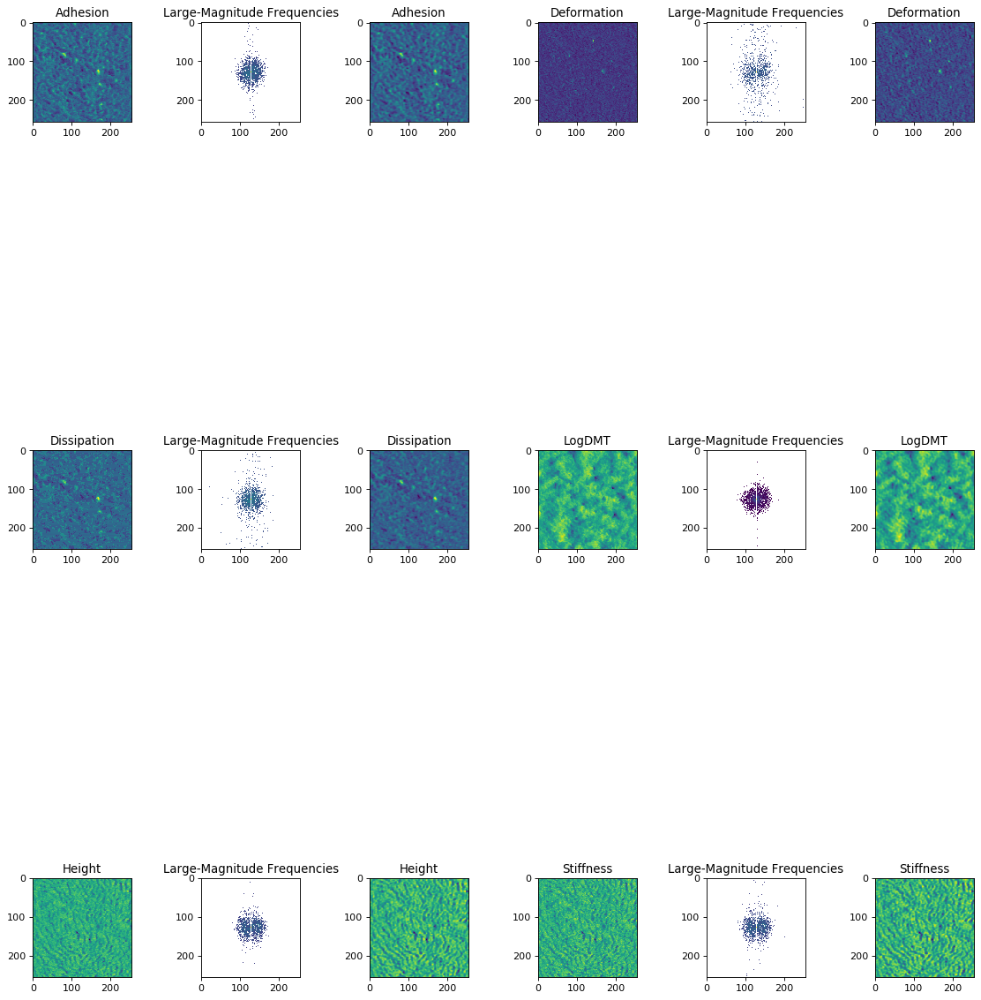

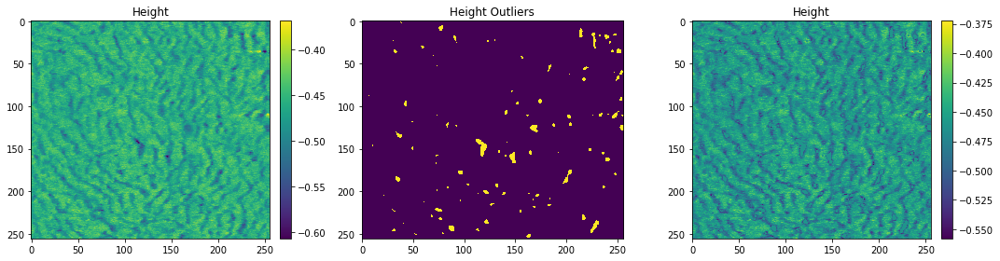

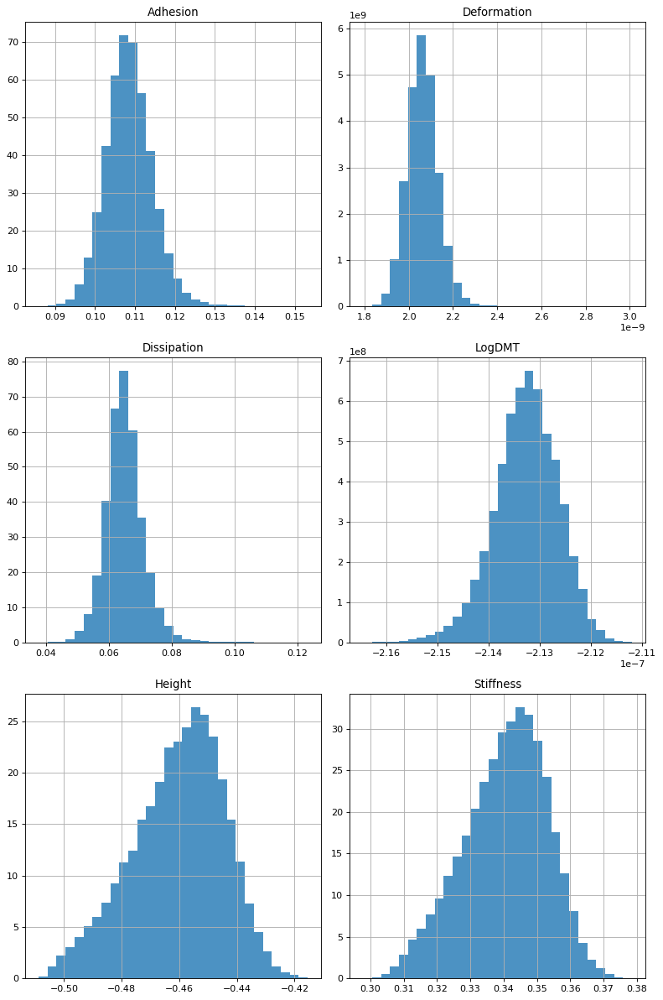

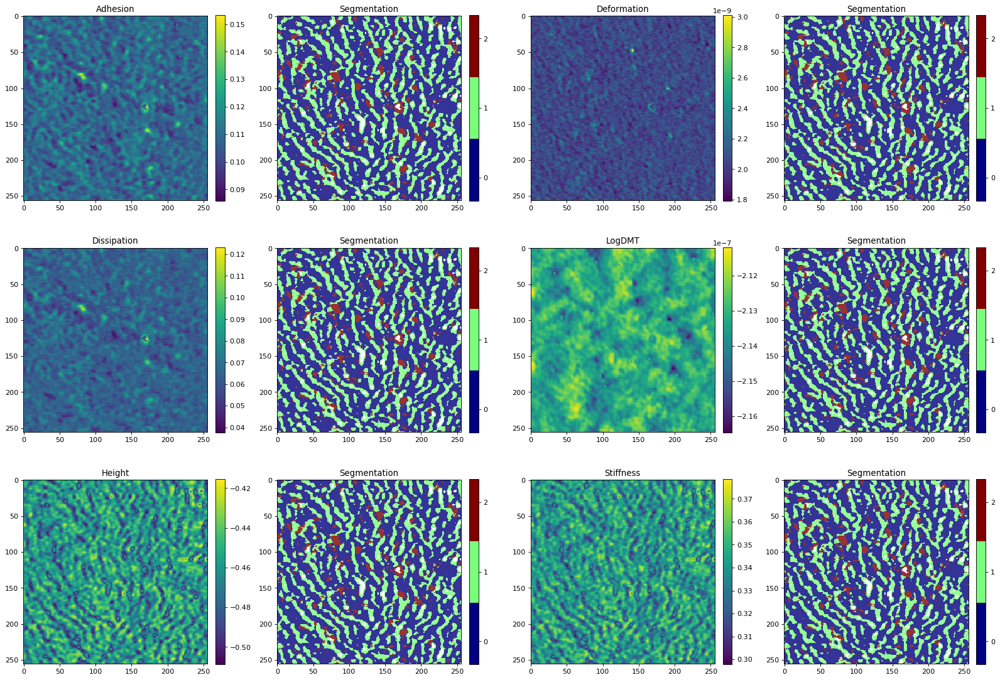

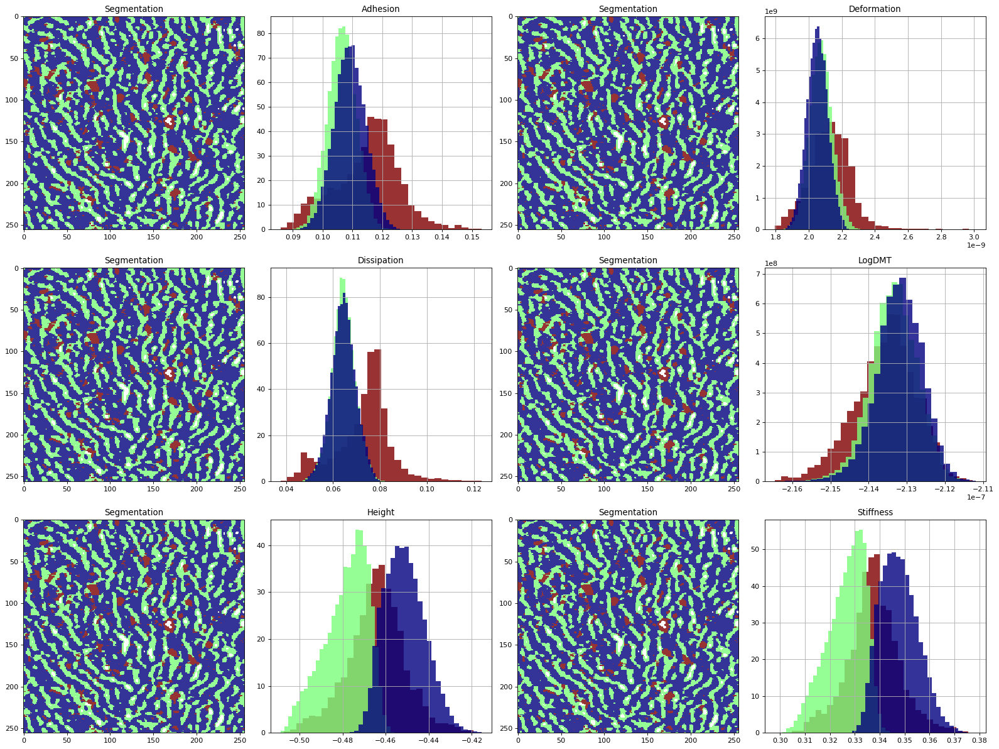

...

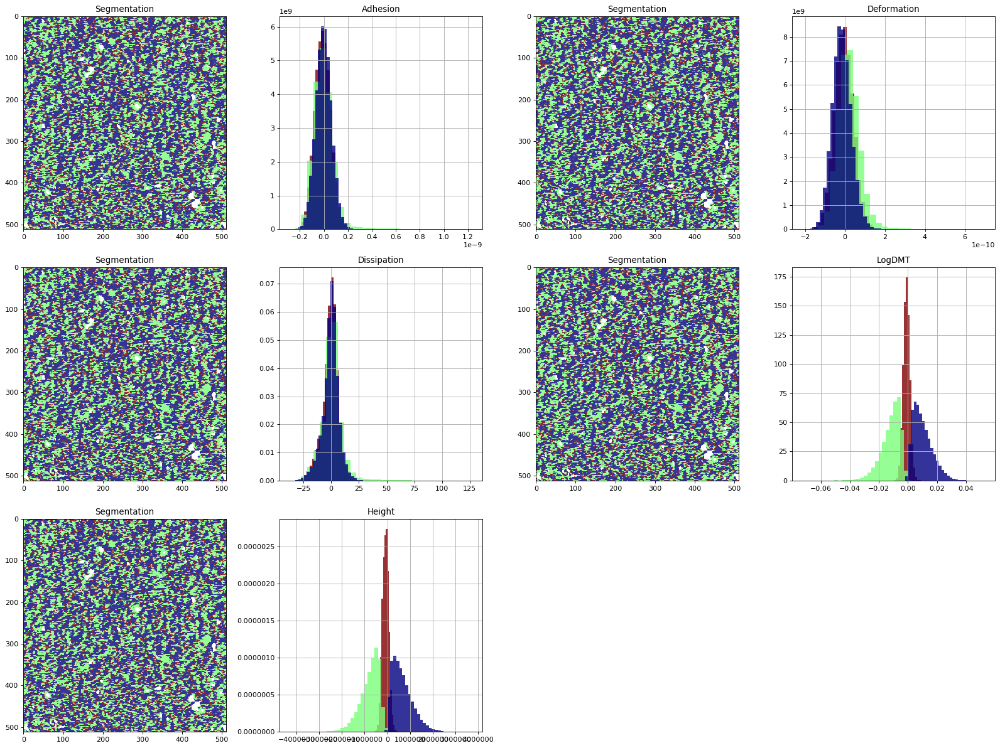

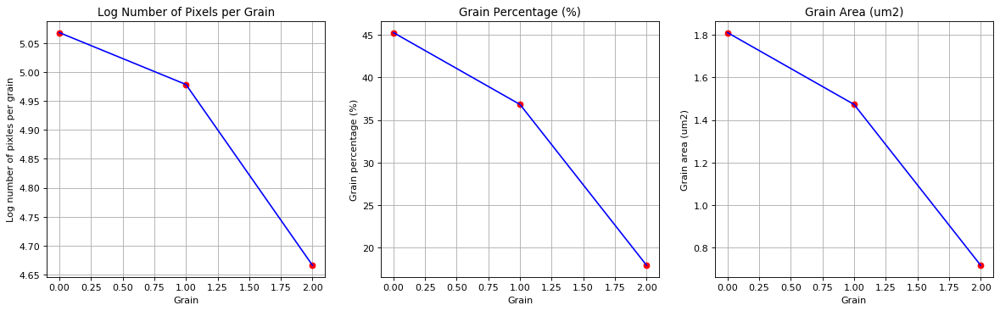

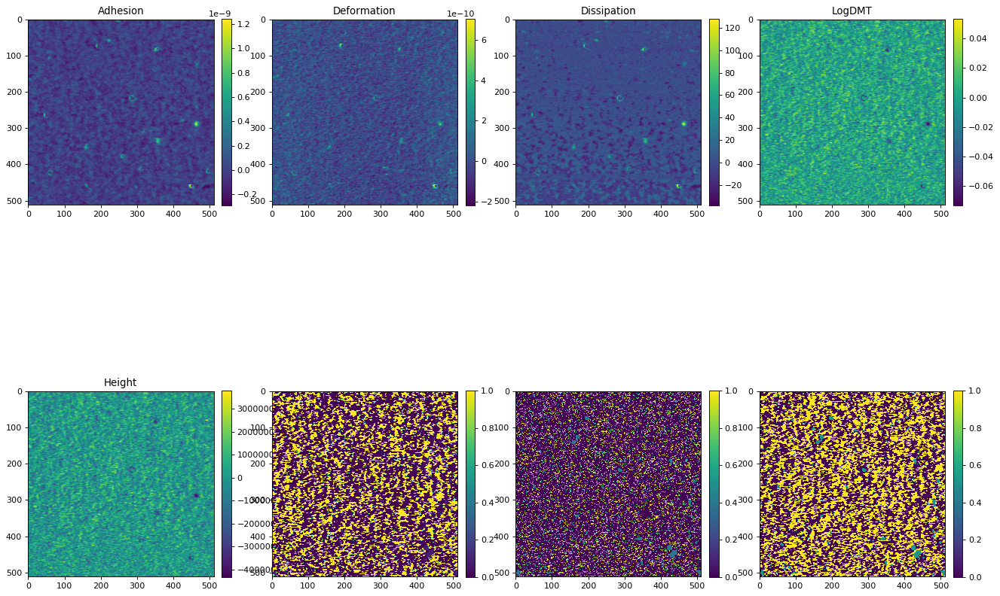

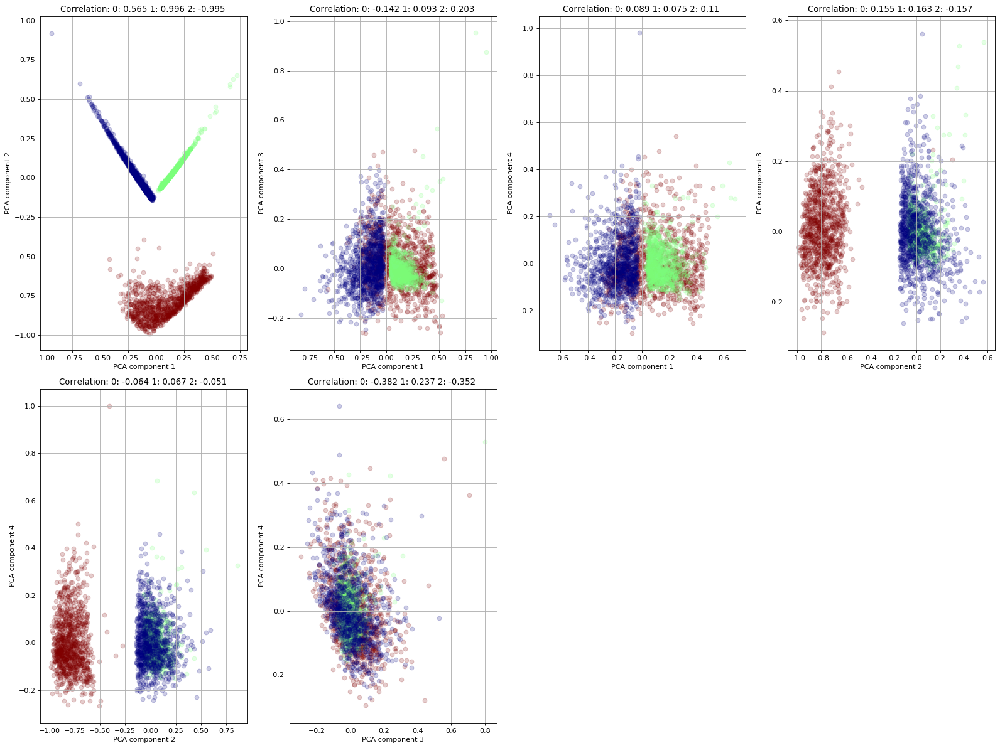

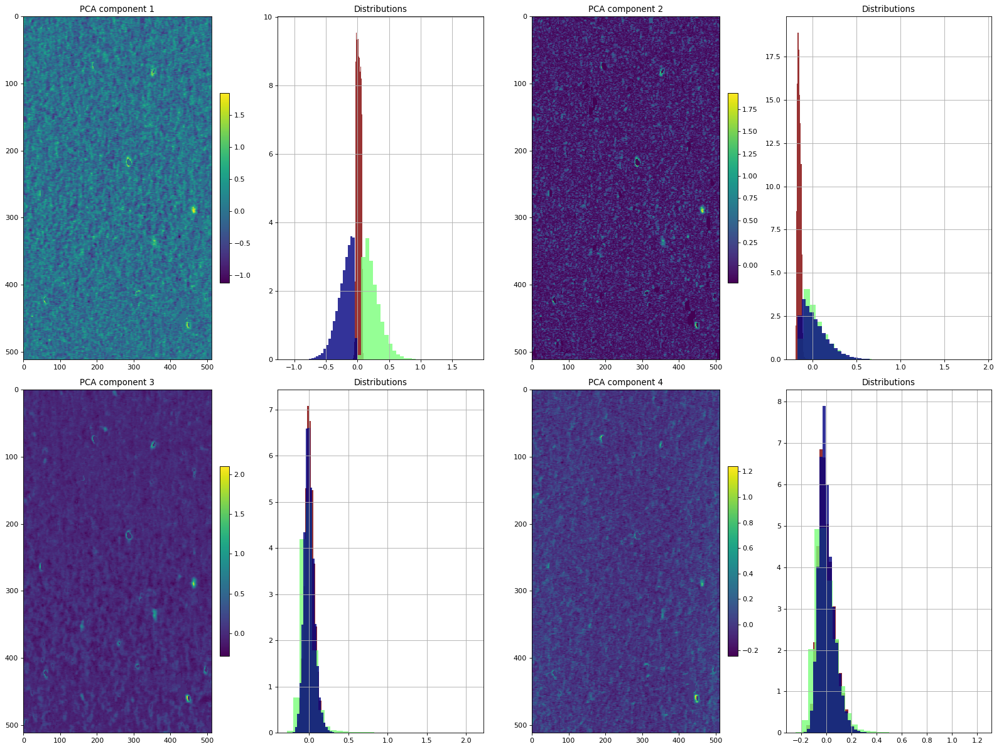

RuntimeError: Locator attempting to generate 1210 ticks from 0.0 to 1210.0: exceeds Locator.MAXTICKS

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x119b17ea0> (for post_execute):


RuntimeError: Locator attempting to generate 1210 ticks from 0.0 to 1210.0: exceeds Locator.MAXTICKS

RuntimeError: Locator attempting to generate 1210 ticks from 0.0 to 1210.0: exceeds Locator.MAXTICKS

<Figure size 1600x1120 with 20 Axes>

In [24]:
n_components = [3, 3, 2, 3, 2, 3, 3]
heightless = [False, False, False, True, False, False, False]
outlier_threshold = [2.5, 2.5, 2.5, 2.5, 4, 4.5, 4.5]
padding = [0, 0, 1, 0, 1, 1, 1]
embedding_dim = [4, 4, 4, 4, 4, 2, None]
thresh = [0.005, 0.001, 0.4, 0.01, 0.004, 0.006, 0.001]
nonlinear = [False, True, True, True, True, False, False, False]
normalize = True
zscale = False
data_type = ['QNM', 'QNM', 'QNM', 'QNM', 'QNM',  'cAFM', 'AMFM']
data_subtype = ['2ComponentFilms', '2ComponentFilms', '2ComponentFilms', 'Backgrounded',
                'Nanowires', 'Nanowires', 'Nanowires']

p_stats = {}
g_stats = {}

phases = {}
grains = {}
correlated_labels = {}

for h, im in enumerate(ims):
    outliers, seg1_labels, seg2_labels = ssts_pipeline(im, heightless = heightless[h],
                                                       n_components = n_components[h],
                                                       outlier_threshold = outlier_threshold[h],
                                                       padding = padding[h],
                                                       embedding_dim = embedding_dim[h],
                                                       thresh = thresh[h],
                                                       nonlinear = nonlinear[h],
                                                       normalize = normalize,
                                                       zscale = zscale,
                                                       data_type = data_type[h],
                                                       data_subtype = data_subtype[h])
    
    p_stats[h] = get_stats_dict(seg1_labels, im)
    g_stats[h] = get_stats_dict(seg2_labels, im)
    
    phases[h] = sh.phase_sort(im, seg1_labels, n_components)
    grains[h] = sh.grain_sort(im, seg2_labels)
    
    correlated_labels[h] = label_comparison(seg1_labels, seg2_labels)
    

### Sorting pixels into phases by GMM label


In [25]:
def phase_sort(array, phase_labels, n_components):
    """
    Takes in a 3D numpy array and sorts pixels into a dictionary based on phase labels
    
    Args:
    array – np.array() of SPM data
    phase_labels – np.array() of phase labels
    n_components – number of phases for sorting
    
    Returns:
    phases – dictionary of numpy arrays, where each key is the phase number and each value is
        a flattened array of the pixels in that phase and their properties
    """
    x,y,z = array.shape

    data = np.reshape(array, ((x*y), z))
    labels = np.reshape(phase_labels, (x*y))

    phase0 = []
    phase1 = []
    phase2 = []
    phase3 = []
    phase4 = []
    phase5 = []
    phase6 = []
    phase7 = []
    phase8 = []
    phase9 = []

    for i in range(len(labels)):
        if labels[i] == 0:
            phase0.append(data[i, :])
        elif labels[i] == 1:
            phase1.append(data[i, :])
        elif labels[i] == 2:
            phase2.append(data[i, :])
        elif labels[i] == 3:
            phase3.append(data[i, :])
        elif labels[i] == 4:
            phase4.append(data[i, :])
        elif labels[i] == 5:
            phase5.append(data[i, :])
        elif labels[i] == 6:
            phase6.append(data[i, :])
        elif labels[i] == 7:
            phase7.append(data[i, :])
        elif labels[i] == 8:
            phase8.append(data[i, :])
        elif labels[i] == 9:
            phase9.append(data[i, :])
        else:
            pass
        
    phases = {}
    
    if len(phase0) >= 1:
        phases[0] = np.asarray(phase0)
    else:
        pass
    
    if len(phase1) >= 1:
        phases[1] = np.asarray(phase1)
    else:
        pass
    
    if len(phase2) >= 1:
        phases[2] = np.asarray(phase2)
    else:
        pass
    
    if len(phase3) >= 1:
        phases[3] = np.asarray(phase3)
    else:
        pass
    
    if len(phase4) >= 1:
        phases[4] = np.asarray(phase4)
    else:
        pass
    
    if len(phase5) >= 1:
        phases[5] = np.asarray(phase5)
    else:
        pass
    
    if len(phase6) >= 1:
        phases[6] = np.asarray(phase6)
    else:
        pass
    
    if len(phase7) >= 1:
        phases[7] = np.asarray(phase7)
    else:
        pass
    
    if len(phase8) >= 1:
        phases[8] = np.asarray(phase8)
    else:
        pass
    
    if len(phase9) >= 1:
        phases[9] = np.asarray(phase9)
    else:
        pass
    
    return phases

### Plotting all of the property distributions of a single phase within a flattened scan

In [26]:
def plot_single_phase_props(array):
    """
    Takes in a flattened array of SPM data and plots the histogram distributions of a single phase of the data
    
    Args:
    array – np.array() of SPM data
    
    Returns:
    plots figures
    """
    xy,z = array.shape
    print ("Shape: ", array.shape)

    fig = plt.figure(figsize=(10,15))
    for i in range(z):
        counts, bins = np.histogram(array[:,i], bins = 30)
        ymax = counts.max()

        median, std_dev, var = array_stats(array[:,i])

        plt.subplot(3,2,1+i)
        plt.hist(array[:,i], bins = 30, alpha = 0.5)
        plt.plot([median, median], [0, ymax+5], label = 'Median', linewidth = 3, c = 'r')
        plt.plot([median+std_dev, median+std_dev], [0,ymax+5], label = 'Std Dev', linewidth = 2, c = 'k')
        plt.plot([median-std_dev, median-std_dev], [0,ymax+5], linewidth = 2, c = 'k')
        plt.title(f'{qnm_fields[i]}'+'  Median: '+ '{:.2e}'.format(median)+',   Stand. Dev.: '+'{:.2e}'.format(std_dev))
        plt.ylim(0, ymax+5)
        plt.legend()

    plt.tight_layout()
    plt.show()
    
    return


### Takes in dictionary of phases from phase_sort() and plots all phases

In [27]:
def plot_all_phases_props(phases):
    """
    Takes in a flattened array of SPM data and plots the histogram distributions of all phases of the data
    
    Args:
    phases – dictionary of numpy arrays, where each key is the phase number and each value is
        a flattened array of the pixels in that phase and their properties
    
    Returns:
    plots figures
    """
    for k, v in phases.items():
        print ('Phase ', k,)
        plot_single_phase_props(v)

In [28]:
phases = phase_sort(im1_opv, seg1_labels, n_components = 5)
plot_all_phases_props(phases)

ValueError: cannot reshape array of size 262144 into shape (65536,)

### Uses the generated dictionary of phases from phase_sort() to generate new, parallel dictionary of stats

In [29]:
def gen_phase_stats(phases):
    """
    Takes in dictionary of phases from phase_sort() and generates a parallel dictionary of stats
    
    Args:
    phases – dictionary of numpy arrays, where each key is the phase number and each value is
        a flattened array of the pixels in that phase and their properties
        
    Returns:
    phase_stats – dictionary of numpy arrays, where each key is the phase number and each value is
        a flattened array of the basic statistical analysis of the phase properties
    """
    phase_stats = {}
    keys = ['median', 'standard deviation', 'variance']

    for k, v in phases.items():
        xy, z = v.shape
        for i in range(z):
            phase_stats[k] = {}
        for h in range(z):
            phase_stats[k][h] = array_stats(v[:,h])
            
    return phase_stats

In [30]:
gen_phase_stats(phases)

AttributeError: 'dict' object has no attribute 'shape'

### Next, the above functions are adapted from single phases within the whole scan to single domains within the whole scan

In [31]:
array = ims[2]
grain_labels = seg2_labels
    
def grain_sort(array, grain_labels):
    """
    Takes in an array and the associated domain (grain) labels. Sorts pixels into a dictionary, where each value is
    an array of the pixel values in the domain
    
    Args:
    array – np.array() of SPM data
    domain_labels – np.array() of domain labels
    n_components – number of phases for sorting
    
    Returns:
    grain_props – dictionary of numpy arrays, where each key is the phase number and each value is
        a flattened array of the pixels in that grain and their properties
    """
    x,y,z = array.shape

    data = np.reshape(array, ((x*y), z))
    labels = np.reshape(grain_labels, (x*y))

    unique_labels = mm.get_unique_labels(labels)
    unique_labels.sort()

    grain_count = len(unique_labels)

    grain_props = {}
    for h in range(x*y):
        pixel_props = data[h,:]
        label = labels[h]

        if label in grain_props:
            old_value = np.asarray(grain_props[label])
            new_value = np.vstack((old_value, pixel_props))    # Append new pixel vector to old vectors
        else:
            new_value = np.asarray(pixel_props)

        grain_props[label] = new_value
    
    return grain_props

In [32]:
grain_props = domain_sort(array, domain_labels)

NameError: name 'domain_sort' is not defined

In [33]:
print (len(grain_props))
grain_props

NameError: name 'grain_props' is not defined

In [34]:
def gen_grain_stats(grain_props):
    """
    Takes in a dictionary of the different grains, produced by grain_sort(), and calculates basic histogram statistics
    on the constituent pixels
    
    Args:
    grain_props – dictionary of numpy arrays, where each key is the phase number and each value is
        a flattened array of the pixels in that grain and their properties
        
    Returns:
    grain_stats – dictionary of numpy arrays, where each key is the grain number and each value is
        a flattened array of the basic statistical analysis of the grain properties
    """
    grain_stats = {}
    keys = ['median', 'standard deviation', 'variance']
    
    for k,v in grain_props.items():
        grain = np.asarray(v)

        if len(grain.shape) == 1: 
            z = grain.shape
            for i in range(z):
                grain_stats[k] = {}
            
            for i in range(z):
                grain_stats[k][i] = array_stats(grain[i])
        else:
            xy, z = grain.shape
            for i in range(z):
                grain_stats[k] = {}
            
            for i in range(z):        
                grain_stats[k][i] = array_stats(grain[:,i])
            
    return grain_stats

In [35]:
phases = sh.phase_sort(ims[2],seg1_labels,5)

In [36]:
p_stats = sh.gen_phase_stats(phases)

In [37]:
grains = sh.grain_sort(ims[2], seg2_labels)

KeyboardInterrupt: 

In [ ]:
g_stats = sh.gen_grain_stats(grains)

In [ ]:
g_stats

# RMS roughness calculation utilities

In [88]:
def sq_mean_square_difference(channel, av):
    """
    Root-mean-square roughness calculation for the mean difference for each channel of an
    SPM data file.
    
    rms = [1/N * sum((pixel - average_channel_value)^2)]
    
    Parameters
    ----------
    channel : NumPy Array
        2 dimensional array of SPM data.
    av : float64
        average (<z>) value of channel
        
    Returns
    ----------
    msd : float64
        Mean-square-difference values for each pixel in a data channel.
    (z - <z>)^2
    """
    channel = channel
    av = av
    msd = (channel - av) ** 2
    
    return msd

def sq_roughness(data):
    """
    Root-mean-square roughness calculation for the mean difference for each channel of an
    SPM data file.
    
    rms = [(1/N) * sum((pixel - average_channel_value)^2)]
    
    Parameters
    ----------
    data : NumPy Array
        2 or 3 dimensional array of SPM data.
        
    Returns
    ----------
    rms_list : list of float64
        list of Sa (rms roughness) values for each channel in data.
    """
    data = data
    x,y,z = data.shape
    print (x, y, z)
    N = x * y
    avs = []
    rms_list = []

    for i in range(z):
        print (i)
        avs.append(np.median(data[:,:,i]))

    for h in range(z):
        print (h)
        rms_list.append(np.sqrt((1/N) * np.sum(sq_mean_square_difference(data[:,:,h], avs[h]))))
        
    return rms_list





def sa_mean_square_difference(channel, av):
    """
    Root-mean-square roughness calculation for the _absolute_ mean difference for each channel of an
    SPM data file.
    
    rms = [1/N * sum((abs(pixel) - average_channel_value)^2)]
    
    Parameters
    ----------
    channel : NumPy Array
        2 dimensional array of SPM data.
    av : float64
        average (<z>) value of channel
        
    Returns
    ----------
    msd : float64
        Mean-square-absolute-difference values for each pixel in a data channel.
    (|z| - <z>)^2
    """
    channel = channel
    av = av
    msd = (np.abs(channel) - av) ** 2
    
    return msd



def sa_roughness(data):
    """
    Root-mean-square roughness calculation for the _absolute_ mean difference for each channel of an
    SPM data file.
    
    rms = [(1/N) * sum((abs(pixel) - average_channel_value)^2)]
    
    Parameters
    ----------
    data : NumPy Array
        2 or 3 dimensional array of SPM data.
        
    Returns
    ----------
    rms_list : list of float64
        list of Sa (rms roughness) values for each channel in data.
    """
    data = data
    x,y,z = data.shape
    print (x, y, z)
    N = x * y
    avs = []
    rms_list = []

    for i in range(z):
        print (i)
        avs.append(np.median(data[:,:,i]))

    for h in range(z):
        print (h)
        rms_list.append(np.sqrt((1/N) * np.sum(sa_mean_square_difference(data[:,:,h], avs[h]))))
        
    return rms_list


In [87]:
data = ims[0]
print (data.shape)
test = sq_roughness(data)
test1 = sa_roughness(data)

(256, 256, 6)
256 256 6
0
1
2
3
4
5
0
1
2
3
4
5
256 256 6
0
1
2
3
4
5
0
1
2
3
4
5


In [81]:
test

[0.006757668101511147,
 1.2199854769670907e-10,
 0.008064163314955611,
 6.545746879888962e-10,
 0.020613739560546598,
 0.016792660138012776]

In [82]:
test1

[0.006757668101511147,
 1.2199854769670907e-10,
 0.008064163314955611,
 4.2652953372480604e-07,
 0.9201108774945175,
 0.016792660138012776]